In [4]:


import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from fasteda import fast_eda
import librosa
import librosa.display
from IPython.display import Audio
from tqdm import tqdm
import utils



In [5]:
is_in_kaggle_env = utils.get_is_in_kaggle_env()
data_path = '/kaggle/input/birdclef-2023' if is_in_kaggle_env else 'data'

We are running code on Localhost


# Load the Data 


In [6]:
#read train_metadate.csv
df = pd.read_csv(f"{data_path}/eBird_Taxonomy_v2021.csv")
train_metadata = pd.read_csv(f"{data_path}/train_metadata.csv")
train_meta = pd.read_csv(f"additional_data/train_meta_audio_durations.csv")
train_metadata.head(3)


,primary_label,secondary_labels,type,latitude,longitude,scientific_name,common_name,author,license,rating,url,filename
0,abethr1,[],['song'],4.3906,38.2788,Turdus tephronotus,African Bare-eyed Thrush,Rolf A. de By,Creative Commons Attribution-NonCommercial-Sha...,4.0,https://www.xeno-canto.org/128013,abethr1/XC128013.ogg
1,abethr1,[],['call'],-2.9524,38.2921,Turdus tephronotus,African Bare-eyed Thrush,James Bradley,Creative Commons Attribution-NonCommercial-Sha...,3.5,https://www.xeno-canto.org/363501,abethr1/XC363501.ogg
2,abethr1,[],['song'],-2.9524,38.2921,Turdus tephronotus,African Bare-eyed Thrush,James Bradley,Creative Commons Attribution-NonCommercial-Sha...,3.5,https://www.xeno-canto.org/363502,abethr1/XC363502.ogg


In [7]:
train_metadata.describe()

,latitude,longitude,rating
count,16714.000000,16714.000000,16941.000000
mean,12.599897,22.035690,3.727732
std,29.208254,28.743382,1.101060
min,-38.116900,-157.819400,0.000000
25%,-6.256000,5.941125,3.000000
50%,2.359500,26.750650,4.000000
75%,42.787100,36.589850,4.500000
max,71.976900,177.684900,5.000000


In [8]:
train_metadata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16941 entries, 0 to 16940
Data columns (total 12 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   primary_label     16941 non-null  object 
 1   secondary_labels  16941 non-null  object 
 2   type              16941 non-null  object 
 3   latitude          16714 non-null  float64
 4   longitude         16714 non-null  float64
 5   scientific_name   16941 non-null  object 
 6   common_name       16941 non-null  object 
 7   author            16941 non-null  object 
 8   license           16941 non-null  object 
 9   rating            16941 non-null  float64
 10  url               16941 non-null  object 
 11  filename          16941 non-null  object 
dtypes: float64(3), object(9)
memory usage: 1.6+ MB


# Listen to some samples 

In [9]:
audio_abe, sr_abe = librosa.load(f"{data_path}/train_audio/abethr1/XC128013.ogg")
audio_abh, sr_abh = librosa.load(f"{data_path}/train_audio/abhori1/XC127317.ogg")

In [10]:
Audio(data=audio_abe, rate=sr_abe)

In [11]:
Audio(data=audio_abh, rate=sr_abh)

# Data preparation

In [12]:
def ensure_sample_rate(waveform, original_sample_rate, desired_sample_rate=32000):
    # 32000 sample rate is required by the competition
    if original_sample_rate != desired_sample_rate:
        waveform = librosa.resample(waveform, orig_sr=original_sample_rate, target_sr=desired_sample_rate)
    return desired_sample_rate, waveform

In [13]:
audio, sample_rate = librosa.load(f"{data_path}/train_audio/afghor1/XC156639.ogg")
sample_rate, wav_data = ensure_sample_rate(audio, sample_rate)
Audio(wav_data, rate=sample_rate)

 Function to find some duplicated audios

In [14]:
ool_idxs = []

for col in train_metadata.columns:
    col_list = []
    col_list.append(col)
    if col != "url": col_list.append("url")
    if col != "filename": col_list.append("filename")
    train_metadata_dup = train_metadata.drop(columns = col_list)
    dup_idx = list(train_metadata_dup.loc[train_metadata_dup.duplicated(keep = "first")].index)
    print(f"# of duplicates: {len(dup_idx)} --> columns dropped: {col_list}")

    if col == "primary_label":
        ool_idxs.append(dup_idx)
        
train_metadata.loc[sum(ool_idxs, [])]["primary_label"].value_counts()



# of duplicates: 2503 --> columns dropped: ['primary_label', 'url', 'filename']
# of duplicates: 2681 --> columns dropped: ['secondary_labels', 'url', 'filename']
# of duplicates: 3428 --> columns dropped: ['type', 'url', 'filename']
# of duplicates: 2510 --> columns dropped: ['latitude', 'url', 'filename']
# of duplicates: 2512 --> columns dropped: ['longitude', 'url', 'filename']
# of duplicates: 2503 --> columns dropped: ['scientific_name', 'url', 'filename']
# of duplicates: 2503 --> columns dropped: ['common_name', 'url', 'filename']
# of duplicates: 2528 --> columns dropped: ['author', 'url', 'filename']
# of duplicates: 2505 --> columns dropped: ['license', 'url', 'filename']
# of duplicates: 3485 --> columns dropped: ['rating', 'url', 'filename']
# of duplicates: 2503 --> columns dropped: ['url', 'filename']
# of duplicates: 2503 --> columns dropped: ['filename', 'url']


litegr     140
comsan     101
cohmar1     87
eubeat1     86
thrnig1     76
          ... 
reedov1      1
refwar2      1
scthon1      1
slbgre1      1
klacuc1      1
Name: primary_label, Length: 201, dtype: int64

# Visualize spectograms of birds (duplicated audio)

## Function to visualize audio as mel spectogram

In [15]:
def visualize_audio(file1, file2):
    
    path = f"{data_path}/train_audio/"
    filename1 = path + file1
    filename2 = path + file2

    fig, axs = plt.subplots(1, 2, figsize=(16, 8))

    y1, sr1 = librosa.load(filename1)
    spec1 = librosa.display.specshow(librosa.power_to_db(librosa.feature.melspectrogram(y=y1, sr=sr1, n_mels=128, fmax=8000)), 
                                     y_axis='mel', fmax=8000, x_axis='time', ax=axs[0])
    
    axs[0].set_title(f'Mel-Spectrogram | file: {filename1.split("/")[-1]}')
    plt.colorbar(spec1, format='%+2.0f dB', ax=axs[0])

    y2, sr2 = librosa.load(filename2)
    spec2 = librosa.display.specshow(librosa.power_to_db(librosa.feature.melspectrogram(y=y2, sr=sr2, n_mels=128, fmax=8000)), 
                                     y_axis='mel', fmax=8000, x_axis='time', ax=axs[1])
    
    axs[1].set_title(f'Mel-Spectrogram | file: {filename2.split("/")[-1]}')
    plt.colorbar(spec2, format='%+2.0f dB', ax=axs[1])

    print(" " * 5, filename1.split("audio")[1])
    display(Audio(filename1))
    print(" " * 5, filename2.split("audio")[1])
    display(Audio(filename2))

    plt.show()

## Visualize the audio as chromagram

In [16]:
def visualize_audio_chroma(file1, file2):
    
    path = f"{data_path}/train_audio/"
    filename1 = path + file1
    filename2 = path + file2

    fig, axs = plt.subplots(1, 2, figsize=(16, 8))

    y1, sr1 = librosa.load(filename1)
    chroma1 = librosa.feature.chroma_stft(y=y1, sr=sr1)
    librosa.display.specshow(chroma1, y_axis='chroma', x_axis='time', ax=axs[0])
    axs[0].set_title(f'Chromagram | file: {filename1.split("/")[-1]}')

    y2, sr2 = librosa.load(filename2)
    chroma2 = librosa.feature.chroma_stft(y=y2, sr=sr2)
    librosa.display.specshow(chroma2, y_axis='chroma', x_axis='time', ax=axs[1])
    axs[1].set_title(f'Chromagram | file: {filename2.split("/")[-1]}')

    print(" " * 5, filename1.split("audio")[1])
    display(Audio(filename1))
    print(" " * 5, filename2.split("audio")[1])
    display(Audio(filename2))

    plt.show()

## Visualize the audio as waveform plot

In [17]:
def visualize_audio_wave(file1, file2):
    
    path = f"{data_path}/train_audio/"
    filename1 = path + file1
    filename2 = path + file2

    fig, axs = plt.subplots(1, 2, figsize=(16, 8))

    y1, sr1 = librosa.load(filename1)
    librosa.display.waveshow(y1, sr=sr1, ax=axs[0])
    axs[0].set_title(f'Waveform | file: {filename1.split("/")[-1]}')

    y2, sr2 = librosa.load(filename2)
    librosa.display.waveshow(y2, sr=sr2, ax=axs[1])
    axs[1].set_title(f'Waveform | file: {filename2.split("/")[-1]}')

    print(" " * 5, filename1.split("audio")[1])
    display(Audio(filename1))
    print(" " * 5, filename2.split("audio")[1])
    display(Audio(filename2))

    plt.show()


# Common House-Martin

![COMSAN](additional_data/1800.jpg)

      /comsan/XC25127.ogg


      /comsan/XC151332.ogg


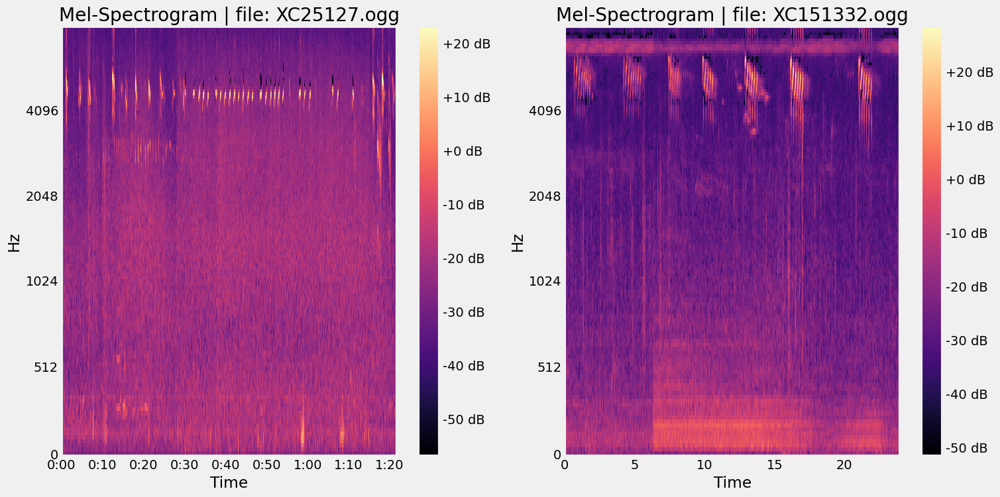

In [18]:
#Common House-Martin
visualize_audio("comsan/XC25127.ogg", "comsan/XC151332.ogg")



      /comsan/XC25127.ogg


      /comsan/XC151332.ogg


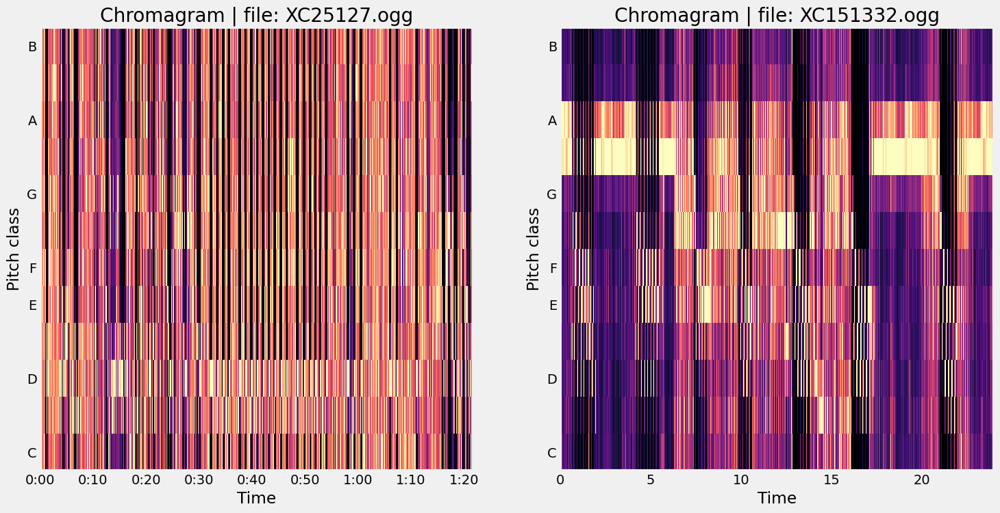

In [19]:
visualize_audio_chroma("comsan/XC25127.ogg", "comsan/XC151332.ogg")

      /comsan/XC25127.ogg


      /comsan/XC151332.ogg


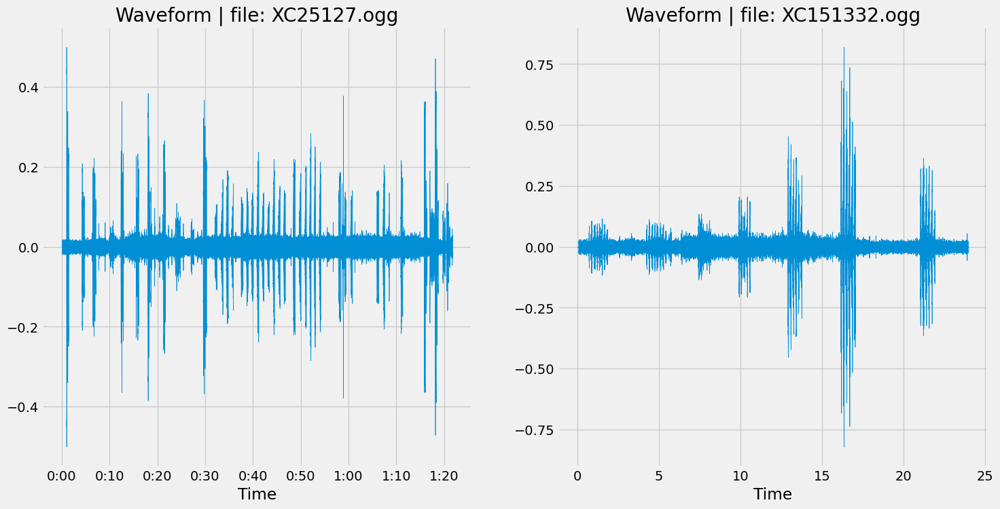

In [20]:
visualize_audio_wave("comsan/XC25127.ogg", "comsan/XC151332.ogg")

# European Bee-eater

![Alt text](additional_data/1801.jpg)

      /eubeat1/XC745284.ogg


      /eubeat1/XC746934.ogg


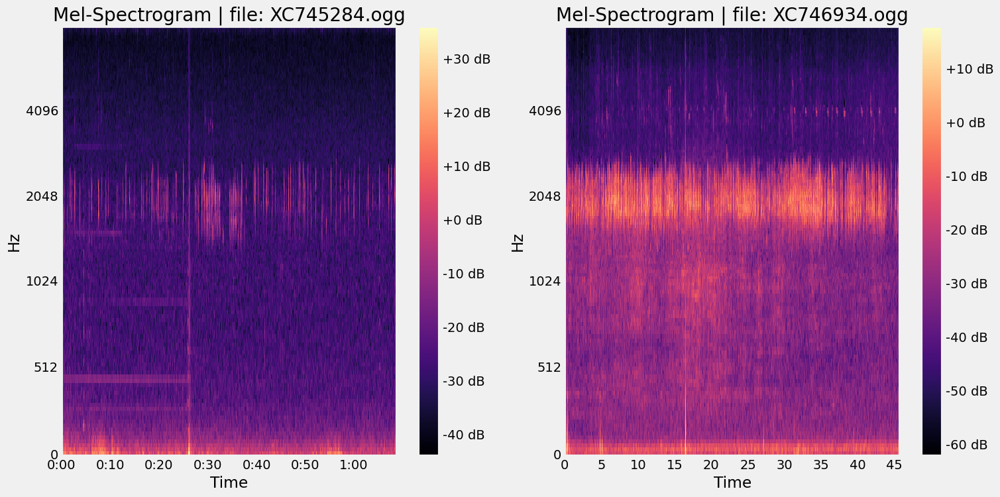

In [21]:
#European Bee-eater
visualize_audio("eubeat1/XC745284.ogg", "eubeat1/XC746934.ogg")

      /eubeat1/XC745284.ogg


      /eubeat1/XC746934.ogg


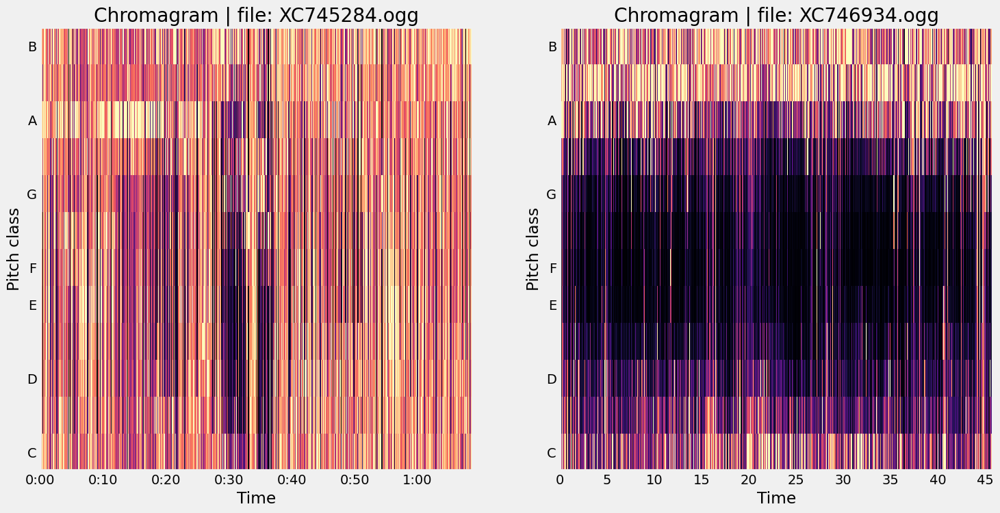

In [22]:
#European Bee-eater
visualize_audio_chroma("eubeat1/XC745284.ogg", "eubeat1/XC746934.ogg")

      /eubeat1/XC745284.ogg


      /eubeat1/XC746934.ogg


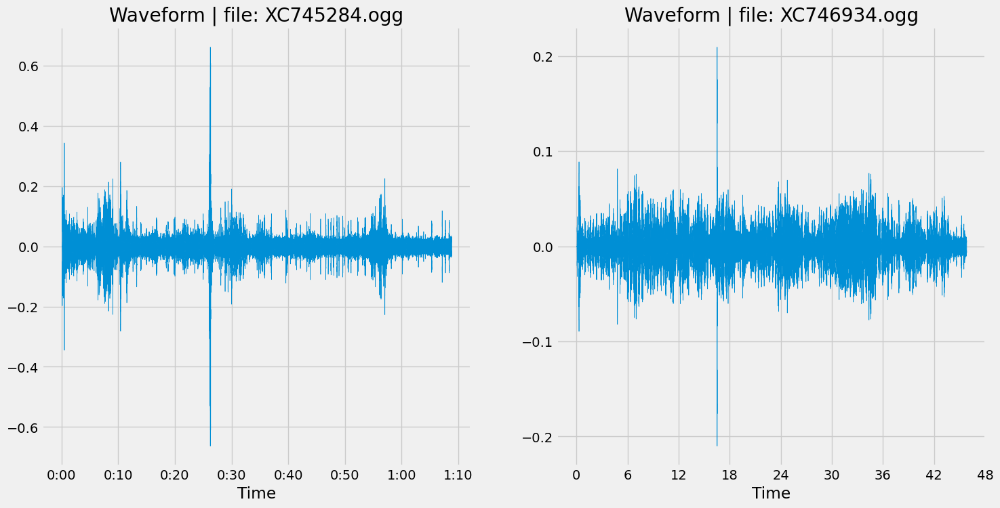

In [23]:
#European Bee-eater
visualize_audio_wave("eubeat1/XC745284.ogg", "eubeat1/XC746934.ogg")

# Eastern Violet-backed Sunbird

![kvbsun1](additional_data/1802.jpg)

      /kvbsun1/XC267766.ogg


      /kvbsun1/XC344743.ogg


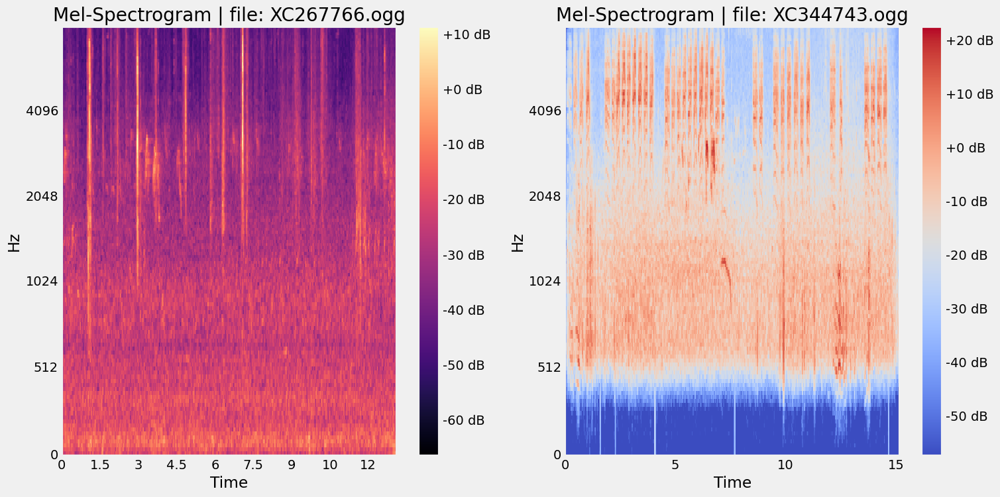

In [24]:
#Eastern Violet-backed Sunbird
visualize_audio("kvbsun1/XC267766.ogg", "kvbsun1/XC344743.ogg")

      /kvbsun1/XC267766.ogg


      /kvbsun1/XC344743.ogg


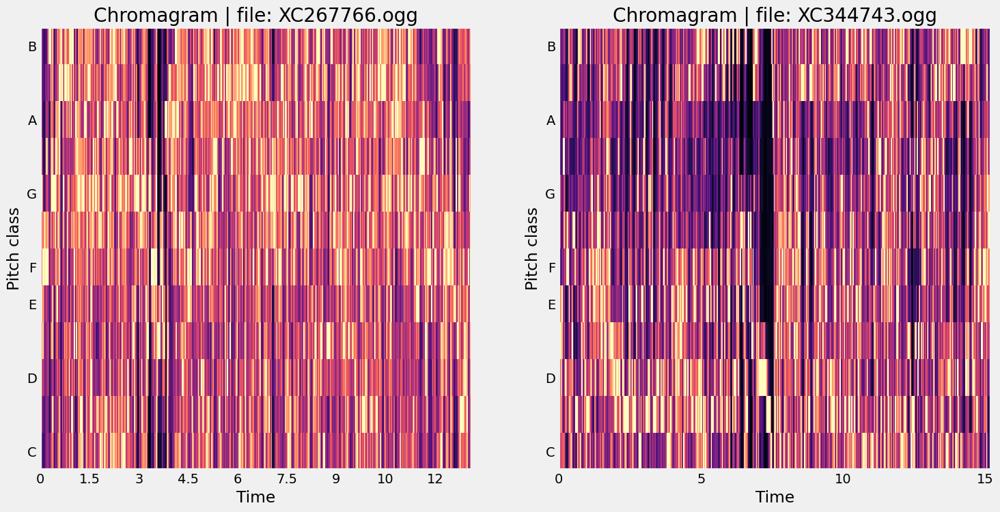

In [25]:
#Eastern Violet-backed Sunbird
visualize_audio_chroma("kvbsun1/XC267766.ogg", "kvbsun1/XC344743.ogg")

      /kvbsun1/XC267766.ogg


      /kvbsun1/XC344743.ogg


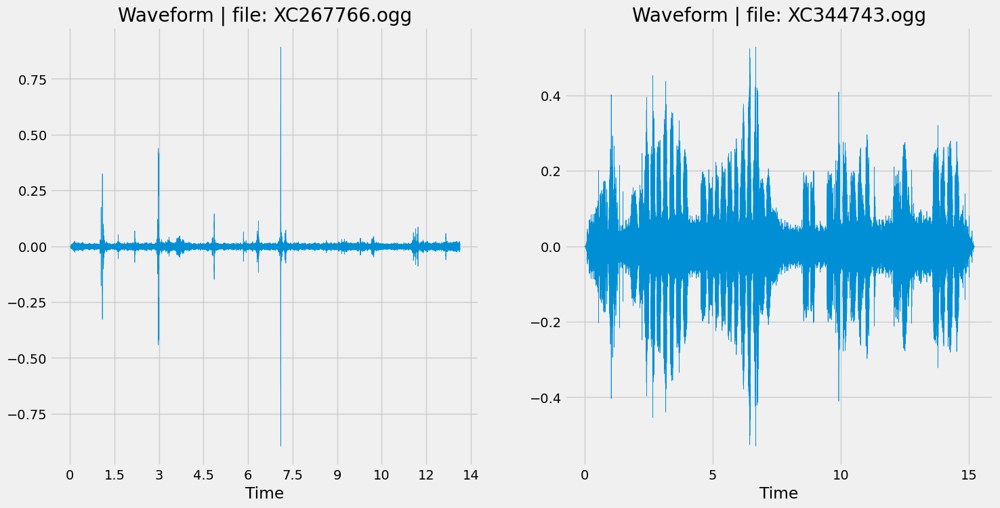

In [26]:
#Eastern Violet-backed Sunbird
visualize_audio_wave("kvbsun1/XC267766.ogg", "kvbsun1/XC344743.ogg")

# Common Buzzard

![combuz](additional_data/combuz.jpg)

      /combuz1/XC180279.ogg


      /combuz1/XC155409.ogg


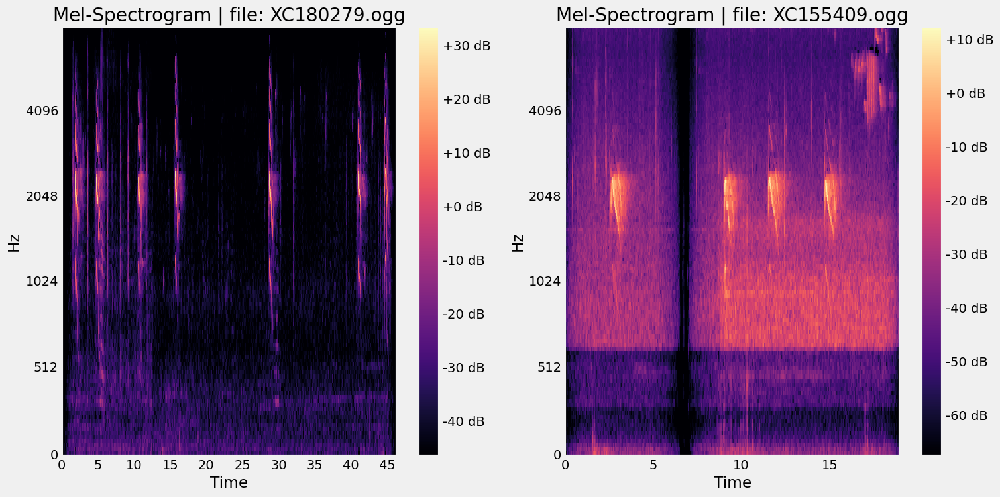

In [27]:
#Common Buzzard
visualize_audio("combuz1/XC180279.ogg", "combuz1/XC155409.ogg")

      /combuz1/XC180279.ogg


      /combuz1/XC155409.ogg


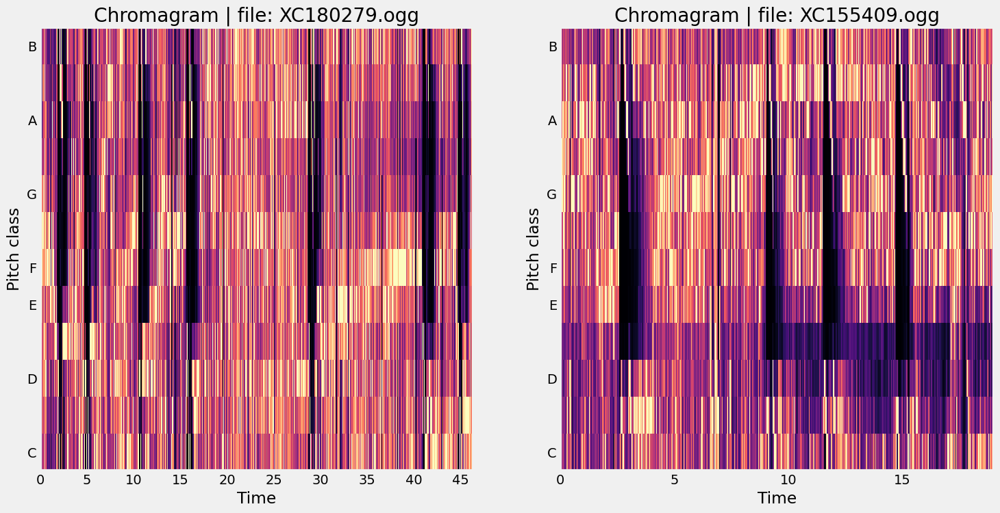

In [28]:
#Common Buzzard
visualize_audio_chroma("combuz1/XC180279.ogg", "combuz1/XC155409.ogg")

      /combuz1/XC180279.ogg


      /combuz1/XC155409.ogg


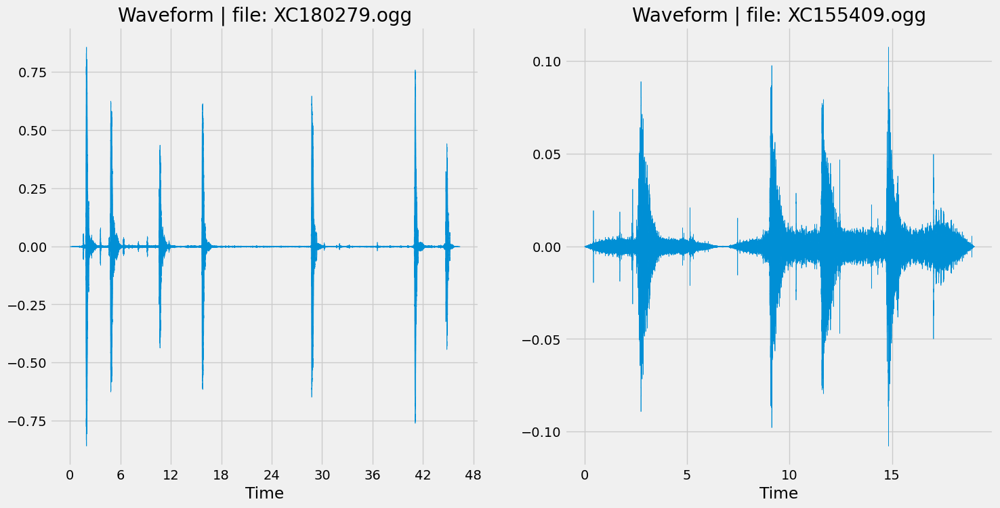

In [29]:
#Common Buzzard
visualize_audio_wave("combuz1/XC180279.ogg", "combuz1/XC155409.ogg")

# Length of the audio files 

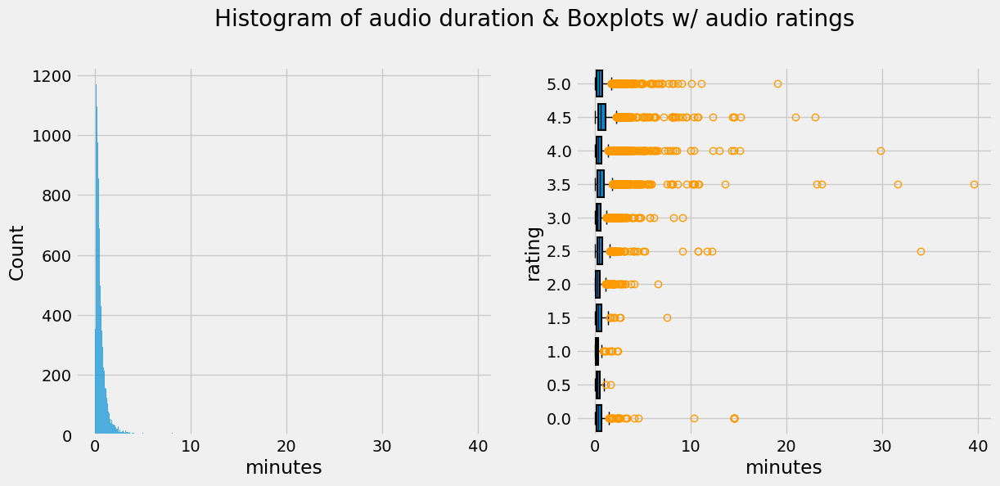

In [30]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize = (14, 6))

sns.histplot(x = train_meta["duration_minutes"], ax = ax1)

box_dict =  {"boxprops":     dict(color = "#000000", linewidth = 1.5),
             "capprops":     dict(color = "#000000", linewidth = 1),
             "medianprops":  dict(color = "#000000", linewidth = 1),
             "whiskerprops": dict(color = "#000000", linewidth = 1),
             "flierprops":   dict(markeredgecolor = "#ff9900"),
             "meanprops":    dict(markeredgecolor = "#000000")}

train_meta.boxplot(by = "rating", column = "duration_minutes", widths = 0.8, 
                   patch_artist = True, vert = False, **box_dict, ax = ax2)

ax1.set_xlabel("minutes")
ax2.set_xlabel("minutes")
ax2.set_title(None)

fig.suptitle("Histogram of audio duration & Boxplots w/ audio ratings", size = 20, y = 1.02)
plt.show()



## 10 Longest audio files

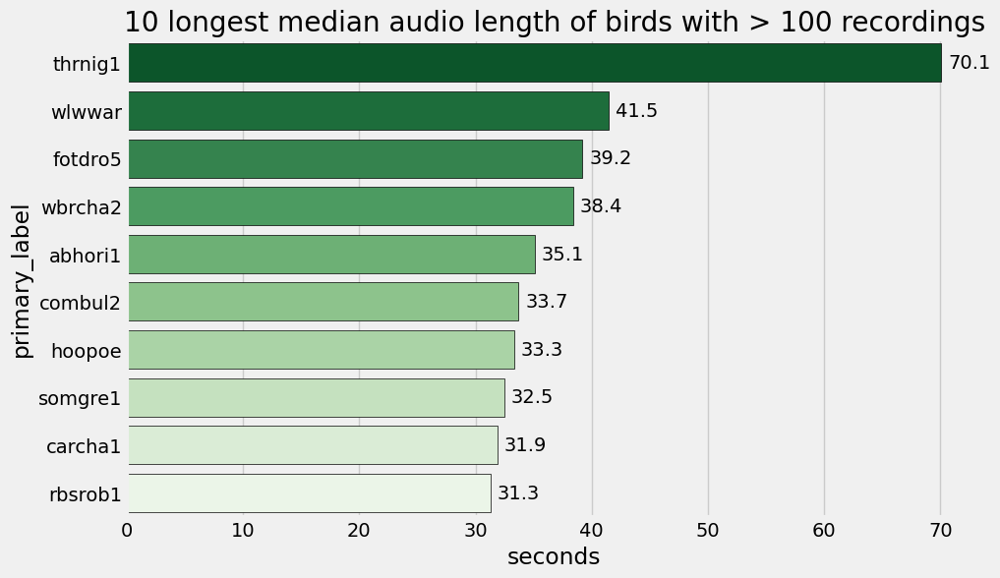

In [31]:
train_meta["primary_label_count"] = train_meta["primary_label"].map(train_meta["primary_label"].value_counts())

plt.figure(figsize = (10, 6))

ax = sns.barplot(x = np.round(train_meta.query("primary_label_count > 100").groupby("primary_label")["duration_seconds"].median().sort_values(ascending = False).values[:10], 1), 
                 y = train_meta.query("primary_label_count > 100").groupby("primary_label")["duration_seconds"].median().sort_values(ascending = False).keys()[:10],
                 palette = "Greens_r", edgecolor = "#000000")

plt.title("10 longest median audio length of birds with > 100 recordings")

for container in ax.containers:
    ax.bar_label(container, padding = 5)
    
ax.set_xlabel("seconds")
plt.show()

# Top 10 audio types

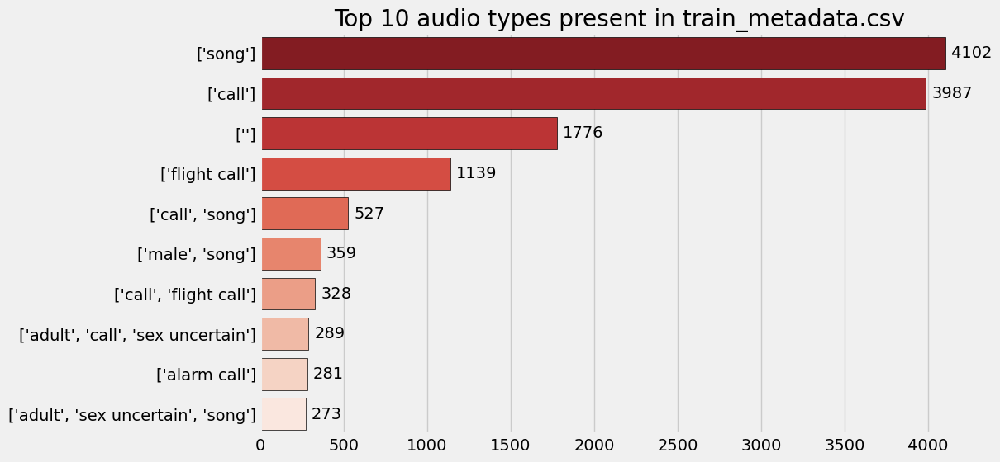

In [32]:
plt.figure(figsize = (10, 6))

ax = sns.barplot(y = list(train_meta.type.value_counts().keys()[:10]), 
                 x = list(train_meta.type.value_counts().values[:10]),
                 palette = "Reds_r", edgecolor = "#000000")

plt.title("Top 10 audio types present in train_metadata.csv")

for container in ax.containers:
    ax.bar_label(container, padding = 5)
    
plt.show()

## Number of audio types for each recording

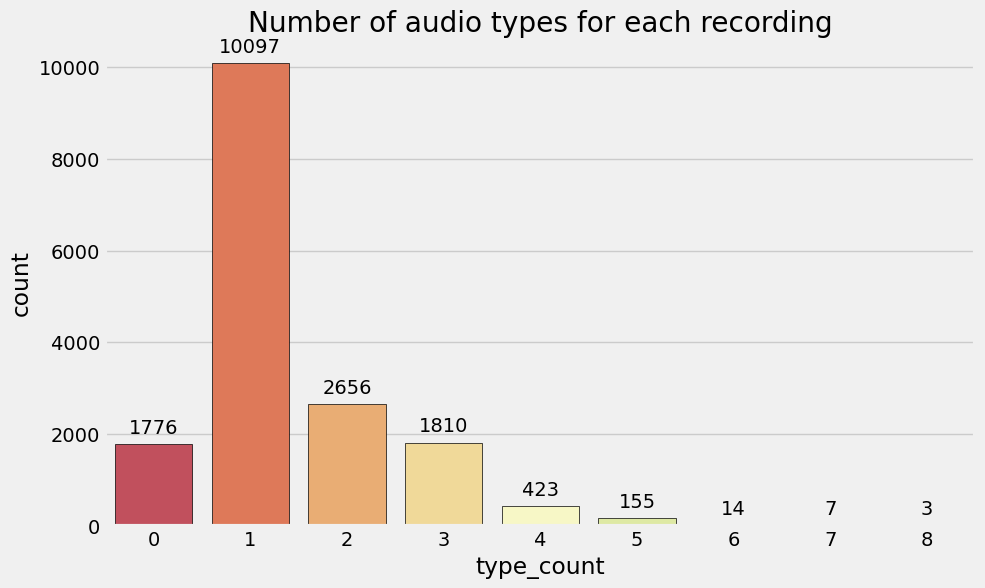

In [33]:
count_df = pd.DataFrame()
count_df['secondary_label_count'] = train_meta['secondary_labels'].apply(lambda x: len(eval(x)) if x != '[]' else 0)
count_df['type_count'] = train_meta['type'].apply(lambda x: len(eval(x)) if x != "['']" else 0)

plt.figure(figsize = (10, 6))

ax = sns.countplot(data = count_df, x = "type_count", 
                   palette = "Spectral", edgecolor = "#000000")

plt.title("Number of audio types for each recording")

for container in ax.containers:
    ax.bar_label(container, padding = 5)

plt.show()

# Secondary labels

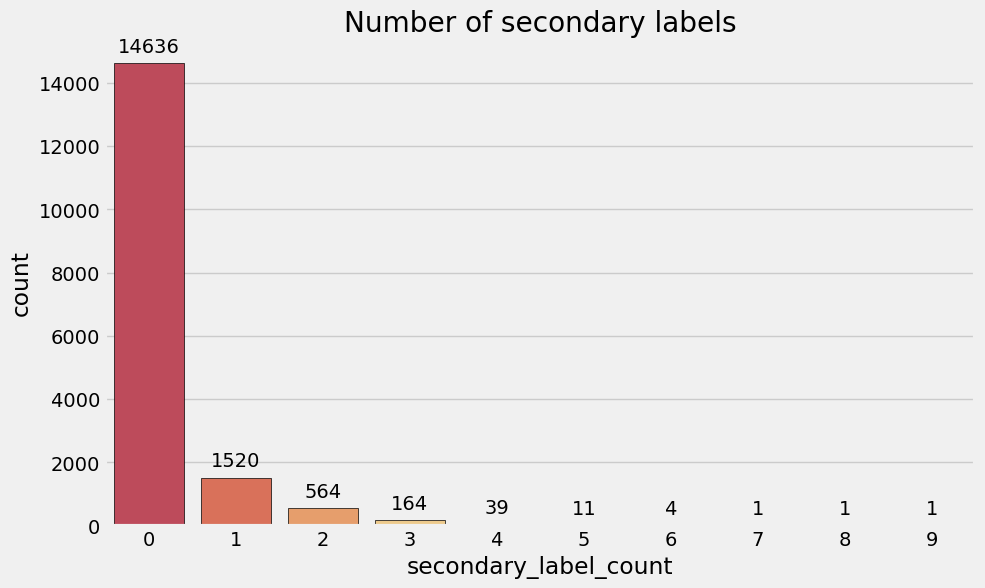

In [34]:
plt.figure(figsize = (10, 6))

ax = sns.countplot(data = count_df, x = "secondary_label_count", 
                   palette = "Spectral", edgecolor = "#000000")

plt.title("Number of secondary labels")

for container in ax.containers:
    ax.bar_label(container, padding = 5)

plt.show()

# Scatterplot of ratings 

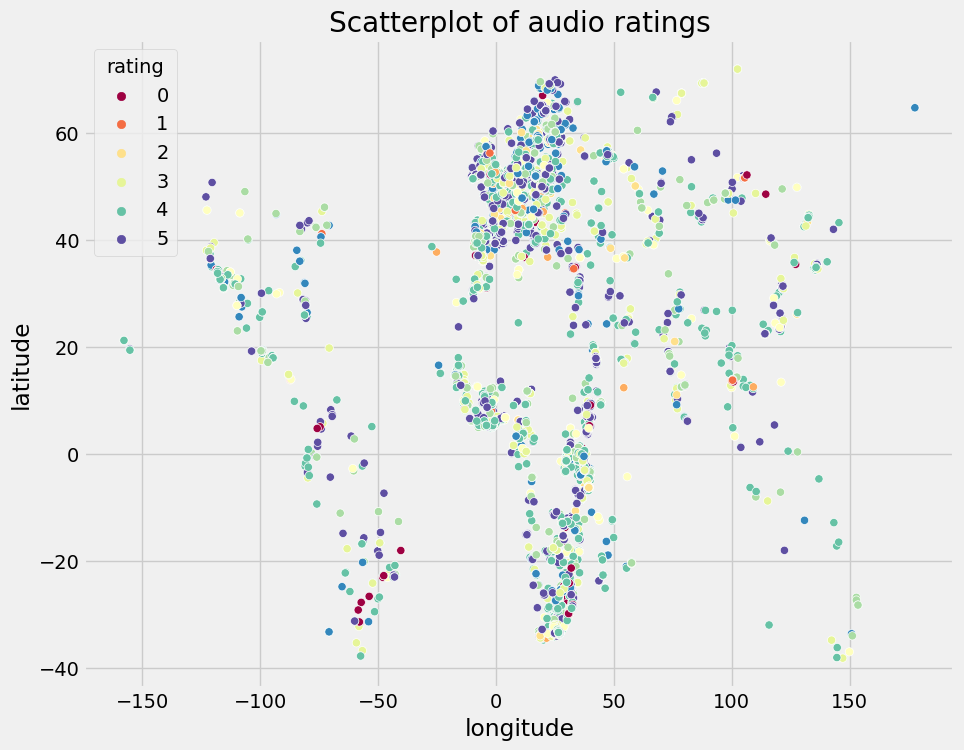

In [35]:
plt.figure(figsize = (10, 8))

sns.scatterplot(data = train_meta, x = "longitude", y = "latitude", 
                hue = "rating", palette = "Spectral")

plt.title("Scatterplot of audio ratings")
plt.show()

DataFrame Head:


,TAXON_ORDER,CATEGORY,SPECIES_CODE,PRIMARY_COM_NAME,SCI_NAME,ORDER1,FAMILY,SPECIES_GROUP,REPORT_AS
0,1,species,ostric2,Common Ostrich,Struthio camelus,Struthioniformes,Struthionidae (Ostriches),Ostriches,NaN
1,6,species,ostric3,Somali Ostrich,Struthio molybdophanes,Struthioniformes,Struthionidae (Ostriches),NaN,NaN
2,7,slash,y00934,Common/Somali Ostrich,Struthio camelus/molybdophanes,Struthioniformes,Struthionidae (Ostriches),NaN,NaN


DataFrame Tail:


,TAXON_ORDER,CATEGORY,SPECIES_CODE,PRIMARY_COM_NAME,SCI_NAME,ORDER1,FAMILY,SPECIES_GROUP,REPORT_AS
16750,34698,spuh,saltat1,saltator sp.,Saltator sp.,Passeriformes,Thraupidae (Tanagers and Allies),NaN,NaN
16751,34699,spuh,passer1,passerine sp.,Passeriformes sp.,Passeriformes,NaN,Others,NaN
16752,35000,spuh,bird1,bird sp.,Aves sp.,NaN,NaN,NaN,NaN


----------------------------------------------------------------------------------------------------
Missing values:


,0
ORDER1,2
FAMILY,13
SPECIES_GROUP,16537
REPORT_AS,12877


----------------------------------------------------------------------------------------------------
MSNO Matrix:



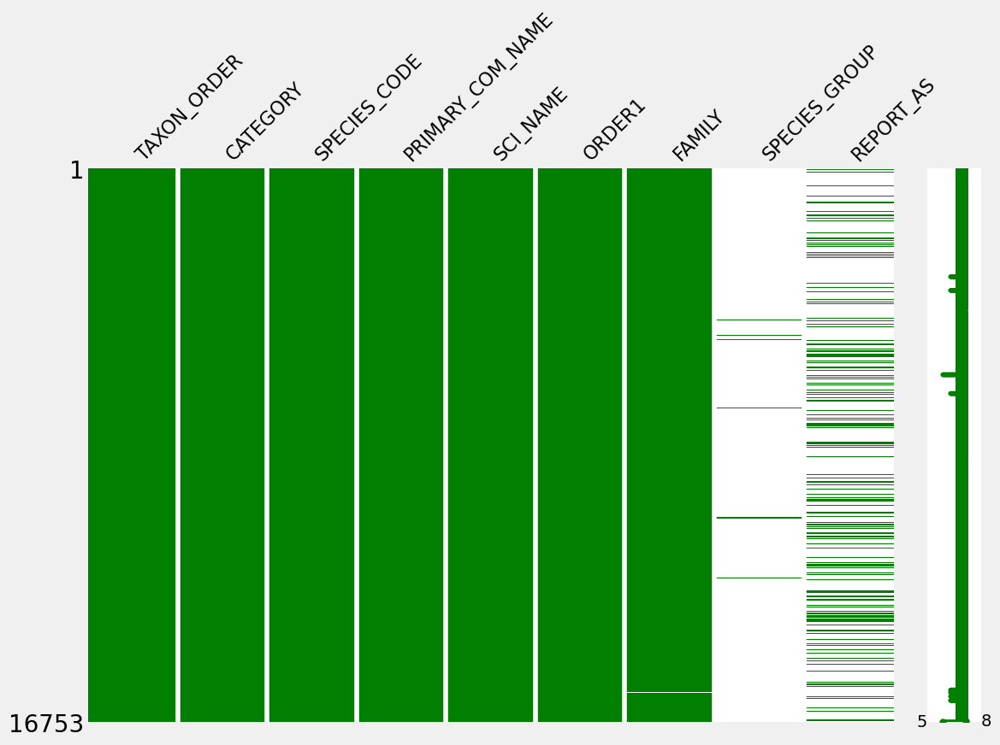

----------------------------------------------------------------------------------------------------
Shape of DataFrame:

(16753, 9)

----------------------------------------------------------------------------------------------------
DataFrame Info:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16753 entries, 0 to 16752
Data columns (total 9 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   TAXON_ORDER       16753 non-null  int64 
 1   CATEGORY          16753 non-null  object
 2   SPECIES_CODE      16753 non-null  object
 3   PRIMARY_COM_NAME  16753 non-null  object
 4   SCI_NAME          16753 non-null  object
 5   ORDER1            16751 non-null  object
 6   FAMILY            16740 non-null  object
 7   SPECIES_GROUP     216 non-null    object
 8   REPORT_AS         3876 non-null   object
dtypes: int64(1), object(8)
memory usage: 1.2+ MB
------------------------------------------------------------------------------------

,count,mean,median,std,min,25%,50%,75%,max,skewness,kurtosis
TAXON_ORDER,16753,16654.013,15976,10185.185,1,7450,15976,25734,35000,0.117444,-1.242761


----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------
Histogram(s) & Boxplot(s):



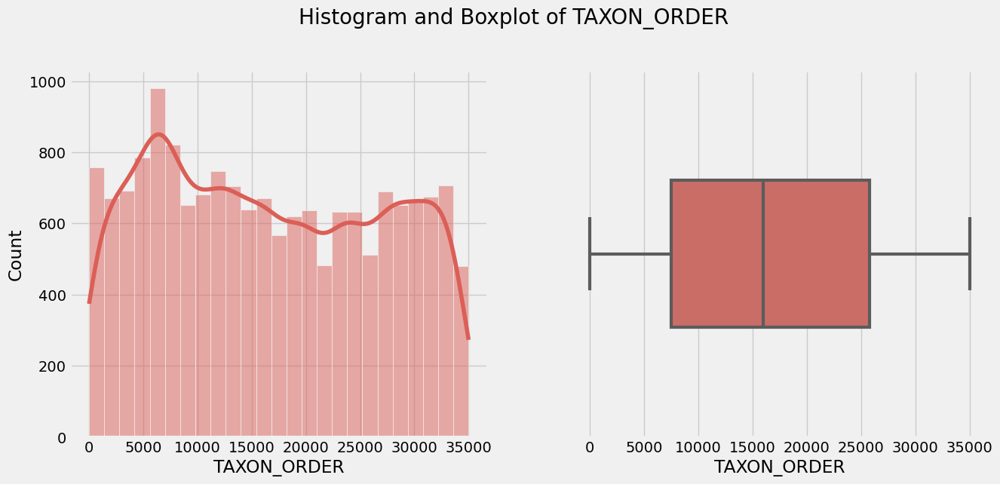

----------------------------------------------------------------------------------------------------
Countplot(s):



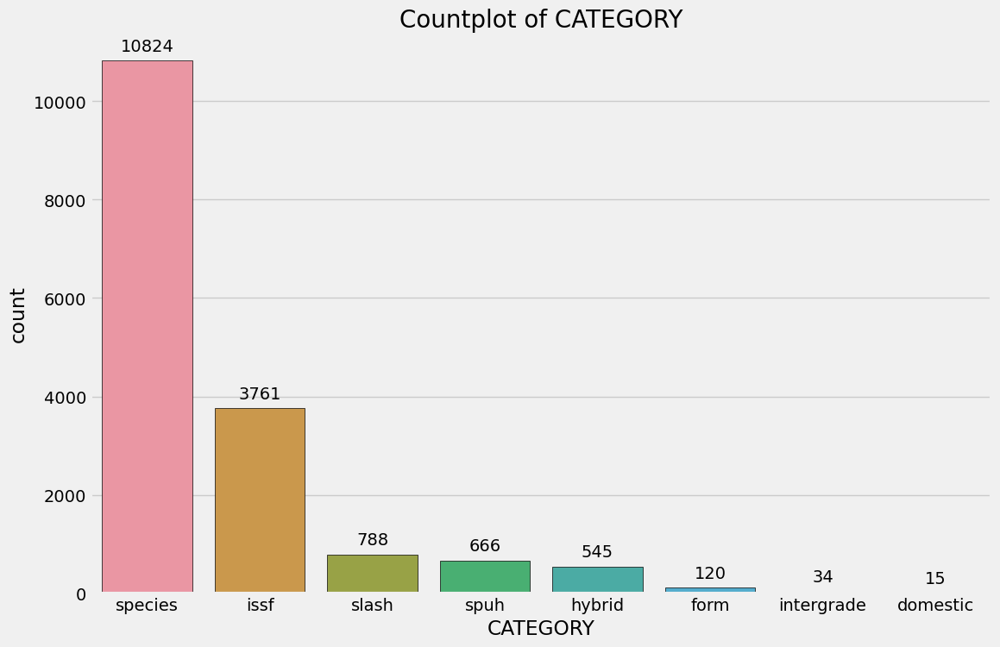

In [36]:
#tried to work with this fast_eda --> for me in anaconda does not work
fast_eda(df, correlation = False, pairplot = False)